<a href="https://colab.research.google.com/github/khuloodnasher/Cancer-Text-Classification/blob/main/classsfying%20texts%20on%20cancer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Connecting google Colab to google Deive to upload data

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')
     

Mounted at /content/drive/


# importing libraries

In [ ]:
# nltk
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import SnowballStemmer
from nltk import FreqDist

# Preprocessing
import re
import string
from sklearn.preprocessing import LabelEncoder, MinMaxScaler
import pandas as pd
import numpy as np
import os

# Modeling
from sklearn.model_selection import KFold, cross_val_score, GridSearchCV 
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from imblearn.over_sampling import SMOTE
from sklearn.svm import LinearSVC
from sklearn.naive_bayes import MultinomialNB
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import accuracy_score, plot_confusion_matrix
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import LabelEncoder, MinMaxScaler

from gensim.models.doc2vec import Doc2Vec, TaggedDocument

# Keras
from keras.preprocessing.text import Tokenizer
#from keras.preprocessing.sequence import pad_sequences
from keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import *

# Plotting
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

#Wordcloud
from wordcloud import WordCloud, STOPWORDS 

#Pillow
from PIL import Image
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import csv
import sys
import pandas as pd

In [ ]:
## To display  all the interactive output without using the print function
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
     


### Define Metrics Function


In [ ]:
### define function for plotting confusion matrix
def plot_confusion_matrix(y_test, y_hat_test):
 # '''
   # First Function for Plotting Confusion Matrix
    #Second Function to Calculate and displays the following: Train and Test Score, Classification Report, 
   # and Confusion Matrix.
    
       # Parameters:
            
          #  clf: classifier or instanciated model from run_model function
          #  y_train: y train from test, train, split
           # y_test: y test from test, train, split
          #  y_hat_test: y hat test from run_model fuction
            
   # '''
    # Print confusion matrix
  cnf_matrix = confusion_matrix(y_test, y_hat_test)
    # Create the basic matrix
  plt.imshow(cnf_matrix,  cmap=plt.cm.Blues)
    # Add title and axis labels
  plt.title('Confusion Matrix')
  plt.ylabel('True label')
  plt.xlabel('Predicted label')
    # Add appropriate axis scales
  class_names = set(y) # Get class labels to add to matrix
  tick_marks = np.arange(len(class_names))
  plt.xticks(tick_marks, class_names, rotation=0)
  plt.yticks(tick_marks, class_names)
    # Add labels to each cell
  thresh = cnf_matrix.max() / 2. # Used for text coloring below
    # Here we iterate through the confusion matrix and append labels to our visualization
  for i, j in itertools.product(range(cnf_matrix.shape[0]), range(cnf_matrix.shape[1])):
    plt.text(j, i, cnf_matrix[i, j],
           horizontalalignment='center',
          color='white' if cnf_matrix[i, j] > thresh else 'black')
    # Add a legend
    plt.colorbar();
    plt.show();
   
def evaluate_model(clf, y_train, y_test, y_hat_train, y_hat_test):
    '''Print out the evaluation metrics for a given models predictions'''
    print(f'Classifier: {clf}', )
    print('-'*60)
    plot_confusion_matrix(y_test,y_hat_test)
    print(f'test accuracy: {accuracy_score(y_test, y_hat_test)}')
    print(f'train accuracy: {accuracy_score(y_train, y_hat_train)}')
    print('-'*60)
    print('-'*60)
    print('Confusion Matrix:\n', pd.crosstab(y_test, y_hat_test, rownames=['Actual'], colnames=['Predicted'],margins = True))
    print('\ntest report:\n' + classification_report(y_test, y_hat_test))
    print('~'*60)
    return [classification_report(y_test, y_hat_test)]
    

In [ ]:
### define our metrics function with plotting confusion matrix
import itertools
from sklearn.metrics import confusion_matrix 

### define function for plotting confusion matrix
def plot_confusion_matrix(y_test, y_hat_test):
  
    # Print confusion matrix
    cnf_matrix = confusion_matrix(y_test, y_hat_test)
    # Create the basic matrix
    plt.imshow(cnf_matrix,  cmap=plt.cm.Blues)
    # Add title and axis labels
    plt.title('Confusion Matrix')
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    # Add appropriate axis scales
    class_names = set(y) # Get class labels to add to matrix
    tick_marks = np.arange(len(class_names))
    plt.xticks(tick_marks, class_names, rotation=0)
    plt.yticks(tick_marks, class_names)
    # Add labels to each cell
    thresh = cnf_matrix.max() / 2. # Used for text coloring below
    # Here we iterate through the confusion matrix and append labels to our visualization
    for i, j in itertools.product(range(cnf_matrix.shape[0]), range(cnf_matrix.shape[1])):
            plt.text(j, i, cnf_matrix[i, j],
                     horizontalalignment='center',
                     color='white' if cnf_matrix[i, j] > thresh else 'black')
    # Add a legend
    plt.colorbar();
    plt.show();
   
def evaluate_model(clf, y_train, y_test, y_hat_train, y_hat_test):
    '''Print out the evaluation metrics for a given models predictions'''
    print(f'Classifier: {clf}', )
    print('-'*60)
    plot_confusion_matrix(y_test,y_hat_test)
    print(f'test accuracy: {accuracy_score(y_test, y_hat_test)}')
    print(f'train accuracy: {accuracy_score(y_train, y_hat_train)}')
    print('-'*60)
    print('-'*60)
    print('Confusion Matrix:\n', pd.crosstab(y_test, y_hat_test, rownames=['Actual'], colnames=['Predicted'],margins = True))
    print('\ntest report:\n' + classification_report(y_test, y_hat_test))
    print('~'*60)
    return [accuracy_score(y_test, y_hat_test), classification_report(y_test, y_hat_test)]
    



### define our metrics function with plotting confusion matrix


##Obtain Data

In [ ]:
import pandas as pd
df = pd.read_csv('/content/drive/My Drive/cancer_text_classification.csv', encoding="ISO-8859-1")


In [ ]:
df.head()
df.info()
df.shape    

,Unnamed: 0,0,a
0,0,Thyroid_Cancer,Thyroid surgery in children in a single insti...
1,1,Thyroid_Cancer,""" The adopted strategy was the same as that us..."
2,2,Thyroid_Cancer,coronary arterybypass grafting thrombosis ï¬b...
3,3,Thyroid_Cancer,Solitary plasmacytoma SP of the skull is an u...
4,4,Thyroid_Cancer,This study aimed to investigate serum matrix ...


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7570 entries, 0 to 7569
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Unnamed: 0  7570 non-null   int64 
 1   0           7570 non-null   object
 2   a           7570 non-null   object
dtypes: int64(1), object(2)
memory usage: 177.5+ KB


(7570, 3)

Drop the column "unnamed' since it is not useful:


In [ ]:
# unnamed not useful better to drop it
df.drop(['Unnamed: 0'], axis=1, inplace=True)
     

In [ ]:
df.head()

,0,a
0,Thyroid_Cancer,Thyroid surgery in children in a single insti...
1,Thyroid_Cancer,""" The adopted strategy was the same as that us..."
2,Thyroid_Cancer,coronary arterybypass grafting thrombosis ï¬b...
3,Thyroid_Cancer,Solitary plasmacytoma SP of the skull is an u...
4,Thyroid_Cancer,This study aimed to investigate serum matrix ...


# Rename the columns

In [ ]:
df.rename({'0':'cancer_type','a':'description'},axis=1,inplace=True)

In [ ]:
df.tail()

,cancer_type,description
7565,Colon_Cancer,we report the case of a 24yearold man who pres...
7566,Colon_Cancer,among synchronous colorectal cancers scrcs rep...
7567,Colon_Cancer,the heterogeneity of cancer cells is generally...
7568,Colon_Cancer,"""adipogenesis is the process through which mes..."
7569,Colon_Cancer,the periparturient period is one of the most c...


# Scrub Data
Check dublicates
check if we have any duplication

In [ ]:
df.duplicated().any()

True

This means I have duplicted entries, that I have to remove to avoid any complications in training my dataset such as inbalance data or overfitting issues.




## Removing Duplicated Entries

In [ ]:
df=df.drop_duplicates()  #  Return DataFrame with duplicate rows removed

# Checking again any dublicates


In [ ]:
df.duplicated().any()

False

### This means we removed all duplicates

In [ ]:
df.shape


(996, 2)

This means we only have 996 observationss which is not enough data to generate a working model that can reusable at research centers.

In [ ]:
# checking missing values
df.isna().sum()
     

cancer_type    0
description    0
dtype: int64

###There is no missing  values

## Explore data
### Explore Target Column which is cancer_type

In [ ]:
df['cancer_type'].unique()

array(['Thyroid_Cancer', 'Colon_Cancer', 'Lung_Cancer'], dtype=object)

In [ ]:
df['cancer_type'].value_counts()/df['cancer_type'].count()*100


Lung_Cancer       45.381526
Thyroid_Cancer    28.413655
Colon_Cancer      26.204819
Name: cancer_type, dtype: float64

## Visualizing Cancer classes


([<matplotlib.patches.Wedge at 0x7fce0f7f7e80>,
 [Text(-1.187390840949736, 0.17350213493982922, 'Lung_Cancer'),
  Text(0.6233326816618759, -0.9063423017669509, 'Thyroid_Cancer'),
  Text(0.8066942340476325, 0.7478264589824992, 'Colon_Cancer')],
 [Text(-0.6926446572206794, 0.10120957871490036, '45.4%'),
  Text(0.33999964454284143, -0.4943685282365186, '28.4%'),
  Text(0.44001503675325404, 0.4079053412631814, '26.2%')])

(-1.2296922219606536,
 1.1140847378136198,
 -1.1123419730833133,
 1.1157347247844285)

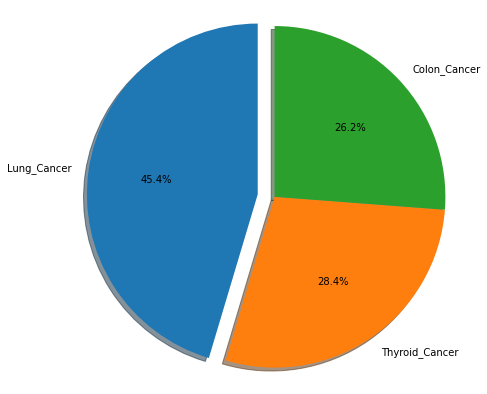

In [ ]:
#  plotting  pie plot
import matplotlib.pyplot as plt
fig = plt.gcf()
fig.set_size_inches(7,7)
plt.pie(df["cancer_type"].value_counts(),labels=('Lung_Cancer','Thyroid_Cancer','Colon_Cancer'),explode = [0.1,0,0],autopct ='%1.1f%%' ,
        shadow = True,startangle = 90,labeldistance = 1.1)
plt.axis('equal')

plt.show()


/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


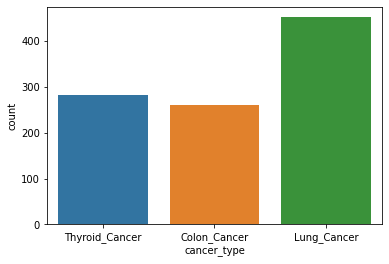

In [ ]:
import seaborn as sns
sns.countplot(df['cancer_type'])

### We can get the  length of every observation

In [ ]:
df['length']=df['cancer_type'].apply(len)


And to plot the length of each observation based on number of characters



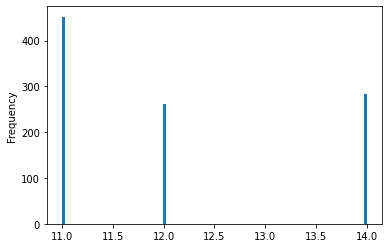

In [ ]:
df['length'].plot(bins=100,kind='hist')

Plotting wordcloud

In [ ]:
! pip install wordcloud
from wordcloud import WordCloud
# convert all the text into a list
sentences=df['description'].tolist()



Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
sentences

     
     


["Thyroid surgery in  children in a single institution from Osama Ibrahim Almosallama Ali Aseerib Ahmed Alhumaida Ali S AlZahranic Saif Alsobhib Saud AlShanafeybFrom the  aDepartment of Surgery College of Medicine Qassim University Buraidah Al Qassim Saudi Arabia  bDepartment of Surgery King Faisal Specialist Hospital and Research Center Riyadh Saudi Arabia cDepartment of Medicine King Faisal Specialist Hospital and Research Center Riyadh Saudi Arabia Correspondence   Dr  Osama Ibrahim  Almosallam  Department of  Surgery  College  of  Medicine Qassim  University  PO  Box   Buraidah  Al  Qassim   Saudi  Arabia  osama_iaahotmailcom ORCID orcid0000000290367564        Citation  Almosallam OI Aseeri A Alhumaid A AlZahrani AS Alsobhi S AlShanafey S Thyroid surgery in  children  in  a  single  institution  from   Ann  Saudi  Med         Received January  Accepted May  Published August  Copyright Copyright   Annals of Saudi Medicine Saudi Arabia This is an   access  under the Creative Commons 

In [ ]:
#  getting the  number of sentences 
len(sentences)

996

which is the same number  of observations

In [ ]:
# join all the sentences i.e. combining all the texts of each observation  in one massive string
sentences_as_one_string= " ".join(sentences) # join all data
     

<Figure size 1440x1440 with 0 Axes>

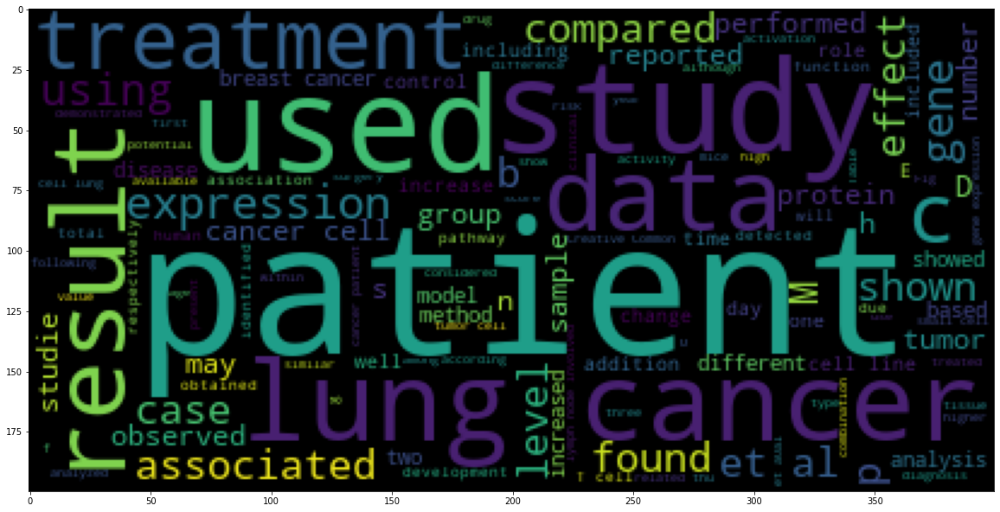

In [ ]:
# now we can plot the word cloud of the whole text data
plt.figure(figsize=(20,20))
plt.imshow(WordCloud().generate(sentences_as_one_string))

from the wordcloud, we can see words such as patient,lung, cancer,cell,treatment,result are the  most frequent woords

We can collect statistical information about my data:



In [ ]:
df.describe()

,length
count,996.000000
mean,12.114458
std,1.256521
min,11.000000
25%,11.000000
50%,12.000000
75%,14.000000
max,14.000000


Now,Let’s take a look at the longest observation:


Now, I will start  the cleaning task which of course will focus on cleaning my  texts  that is located in the description column:
Our cleaning tasks will include the  following steps:
1- Removing punctuation and special characters through regex library.
2-  Lowercasing all words to makes it easier to standardize the data.
3- Removing stop words which are common words that carry little meaning (e.g., "the", "and", "a"). Removing them can reduce the size of the data and improve the accuracy of the classifier.
4- Tokenization through dividing the text into individual words or sentences, known as tokens,  which helps the classifier understand the meaning of the text.
5- Stemming or Lemmatization, by Stemming it  will reduce words to their base form, while lemmatization  will reduce words to their basis meaning. Both techniques can help to standardize the text and improve the accuracy of the classifier. 

## Once the text has been cleaned, it can be transformed into a numerical format suitable for use in a machine learning classifier.

### Perform data cleaning - removing punctuation


In [ ]:
# from beefore
import nltk
nltk.download("stopwords")

# Make a list of stopwords to remove
from nltk.corpus import stopwords
import string
# Get all the stop words in the English language
stopwords_list = stopwords.words('english')
## Add punctuation to stopwords_list
stopwords_list+=string.punctuation
stopwords_list


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [ ]:
#import string
#string.punctuation
   

In [ ]:
#before
# Create a pipeline to remove stop-words, punctuation, and perform tokenization
def message_cleaning(message):
  ''' pipeline function performs the follwoing:
  (1) remove punctiation,
  (2) remove stopwords'''


  Test_punc_removed=[char for char in message if char not in string.punctuation]
  Test_punc_removed_join=''.join(Test_punc_removed)
  Test_punc_removed_join_clean=[word for word in Test_punc_removed_join.split() if word.lower() not in stopwords_list]
  return Test_punc_removed_join_clean
     

In [ ]:
# before
# let's test the newly added function
df_clean=df['description'].apply(message_cleaning)
df_clean.head()
print(df_clean[5]) # cleaning text in index 5
     

0    [Thyroid, surgery, children, single, instituti...
1    [adopted, strategy, used, prior, years, based,...
2    [coronary, arterybypass, grafting, thrombosis,...
3    [Solitary, plasmacytoma, SP, skull, uncommon, ...
4    [study, aimed, investigate, serum, matrix, met...
Name: description, dtype: object

['study', 'performed', 'explore', 'effective', 'management', 'bleeding', 'associated', 'radiofrequency', 'ablation', 'RFA', 'benign', 'thyroid', 'nodulesMethods', 'Thirtyfive', 'patients', 'benign', 'thyroid', 'nodules', 'treated', 'ultrasoundguided', 'RFA', 'July', 'December', 'Third', 'Affiliated', 'Hospital', 'Sun', 'YatsenUniversity', 'retrospectively', 'reviewed', 'technique', 'efficacy', 'bleeding', 'complications', 'assessed', 'followup', 'periodResults', 'mean', 'technique', 'efficacy', '06', 'month', '06', 'months', 'procedure', 'One', 'case', 'intranodular', 'haematoma', 'two', 'cases', 'voicechange', 'month', 'observed', 'patients', 'recovered', 'corresponding', 'treatmentConclusion', 'Although', 'incidence', 'haemorrhage', 'low', 'serious', 'haematomas', 'lifethreatening', 'Therefore', 'comprehensive', 'understanding', 'potential', 'complicationsan', 'accurate', 'clinical', 'strategy', 'adequate', 'technical', 'skills', 'may', 'prevent', 'help', 'properly', 'managethese', '

In [ ]:
# before
df_cleaner = [" ".join(x) for x in df_clean]# return the tokinized text to list of strings i.e. sentence


In [ ]:
#before
# convert the list of strings of tweets into dataframe
new_df = pd.DataFrame(df_cleaner, columns=["description"])
new_df.head()

,description
0,Thyroid surgery children single institution Os...
1,adopted strategy used prior years based four e...
2,coronary arterybypass grafting thrombosis ï¬b...
3,Solitary plasmacytoma SP skull uncommon clinic...
4,study aimed investigate serum matrix metallopr...


In [ ]:
#Data cleaning

#import nltk
#nltk.download('stopwords')
#from nltk.corpus import stopwords

#stop_words = stopwords.words('english')
#df['description'] = df['description'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop_words)]))# removing stop words
#df['description'] = df['description'].str.lower()

#import string

# create function for punctuation removal:
#def remove_punctuations(text):
  #  for char in string.punctuation:
     #   text = text.replace(char, '')
   # return text

# apply the function:
#df['description'] = df['description'].apply(remove_punctuations)

#df.head(5)

PreProcessing Data:
Data will be preprocessed as follows:

Target columns of cancer_type will be  label encoded
while texs in  the  description column will bw tokenized, then  vectorized using one of vectorizer such as TFIDF,or embedding techniques.

In [ ]:
#  tokenizing the texts
#import nltk
#nltk.download('punkt')
#from nltk import word_tokenize,sent_tokenize

#  Tokenizing which is break into words

#df['desription']=df['description'].apply(lambda x:word_tokenize(x))
#df


In [ ]:
# counting the  nummber of charachters  in each cancer class

#df['char_count']=df['description'].apply(len)
# counting the  nummber of words  in each cancer class
#df['word_count']=df['description'].apply(lambda x:len(word_tokenize(x)))
# # counting the  nummber of sentences  in each cancer class
#from nltk.tokenize import sent_tokenize
#df['sentence_count']=df['description'].apply(lambda x:len(sent_tokenize(x)))
#df

It shows te class of lung cancer  has  more long  sentences


In [ ]:
# comparing the number of characters in each cancer  class
#import seaborn as sns
#sns.pairplot(df['cancer_type'])

## Applying text vectorization:
 Text vectorization is the process of converting text data into numerical form,a matrix of token counts that we call it vetors so that it can be analyzed and processed by machine learning algorithms. This is done by creating a mathematical representation of the text, such as a bag of words model, word embeddings, or document-term matrix. The resulting vectors capture the meaning and context of the words in the text and can be used as input features for various machine learning models, such as classification, clustering, or regression algorithms. 
 ## Here,I will use TfidfVectorizer

In [ ]:
#from sklearn.feature_extraction.text import CountVectorizer,TfidfVectorizer

#tfidf=TfidfVectorizer(max_features=4600)
#x=tfidf.fit_transform(df['description']).toarray()
#cv=CountVectorizer(max_features=3000)
#tfidf=TfidfVectorizer(max_features=4600)
#x=tfidf.fit_transform(df['description']).toarray()
#x

AS we can see our text still fulll of unneeded features that is  why we got a sparse matrix  full of zeeros, A sparse matrix is a matrix in which most of the elements are zero. In other words, a sparse matrix is a matrix with a high proportion of zero elements compared to the total number of elements. Storing such a matrix in its dense form, where every element is represented, is inefficient in terms of memory usage. To save memory, sparse matrices use a different representation that only stores the non-zero elements and their positions. This representation is called a sparse representation, and it makes it possible to perform arithmetic operations on sparse matrices with the same time complexity as dense matrices, while using much less memory.

##Train/Test/Split
Before modeling, I still need to perform more preprocessing on my data.I will need to encode my target and tokenize my features as following:



# Encoding Labels

In [ ]:
#before
le = LabelEncoder()

le.fit(df['cancer_type'])

df['target'] = le.transform(df['cancer_type'])
df.tail(50)
     

LabelEncoder()

,cancer_type,description,length,target
946,Lung_Cancer,""" Apoptosis of NSCLC A549 cells after ionizing...",11,1
947,Lung_Cancer,"""Biological Sciences Cell Biology Analysis of ...",11,1
948,Lung_Cancer,"""decreased expression of Hsp70 caused by ibupr...",11,1
949,Lung_Cancer,"""A decrease in Hsp70 by RNAi promoted cisplati...",11,1
950,Lung_Cancer,"""Identifying somatic mutations is critical for...",11,1
951,Lung_Cancer,"""observed depth in DNA-WGS and an alternate pr...",11,1
952,Lung_Cancer,"""reads in RNA-seq but only a few mutant reads ...",11,1
953,Lung_Cancer,"""Urology 1471-2490 BioMed Central 24612599 397...",11,1
954,Lung_Cancer,"""Discussion A previous study on metastatic RCC...",11,1
955,Lung_Cancer,"""peptide vaccine CTL clone lung cancer Introdu...",11,1


### Define X and y and split the data to training/testing, with test-size=40%


#Encoder Classes

In [ ]:
# before
# Dictionary to store sentiment values

target_key = {0: le.classes_[0], 1: le.classes_[1], 2: le.classes_[2]}
print(target_key)
     

{0: 'Colon_Cancer', 1: 'Lung_Cancer', 2: 'Thyroid_Cancer'}


Define X and y


In [ ]:
# before
from sklearn.model_selection import train_test_split

X = df['description']
y = df['target']

X_train, X_test, y_train, y_test = train_test_split(X, y, stratify = y,test_size=0.40,
                                                    random_state=123,shuffle=True)
   

In [ ]:
#  before
y_test.value_counts()



1    181
2    113
0    105
Name: target, dtype: int64

In [ ]:
# before
y_train.value_counts()


1    271
2    170
0    156
Name: target, dtype: int64

In [ ]:
# defining tokenizer function for classifying text in pipeline
import nltk
nltk.download('punkt')

from nltk.tokenize import word_tokenize

def text_tokenizer(text):
    return word_tokenize(text) #  function that takes in a string of text and returns a list of tokens



[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

Part 1: TfidfVectorizer:
Vectorization:
TF-IDF

Classifiers:
LinearSVC, SGDClassifier,LogisticRegression,Random Forest balanced with smote and gridserch tuned, Multinomial NB, Adaboost, XGBoost, Neural Network

Train-Test Split: 60% Training, 40% Testing Evaluation: Confusion Matrix, Classification Report, Accuracy Score

#LinearSVC

In [ ]:
# before
from sklearn.pipeline import Pipeline
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.svm import LinearSVC
from sklearn.naive_bayes import MultinomialNB

from sklearn.metrics import precision_score, recall_score, f1_score


In [ ]:
linear_svc = Pipeline([('tfidf', TfidfVectorizer(lowercase=True, stop_words=stopwords_list,
                                                 tokenizer=text_tokenizer)),
                     ('clf', LinearSVC(class_weight='balanced'))])

linear_svc.fit(X_train, y_train)

     


/usr/local/lib/python3.8/dist-packages/sklearn/feature_extraction/text.py:396: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ["'d", "'ll", "'re", "'s", "'ve", '``', 'could', 'might', 'must', "n't", 'need', 'sha', 'wo', 'would'] not in stop_words.
  warnings.warn(


Pipeline(steps=[('tfidf',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('clf', LinearSVC(class_weight='balanced'))])

In [ ]:
# prediction
y_hat_train=linear_svc.predict(X_train)
y_hat_test = linear_svc.predict(X_test)



Classifier: Pipeline(steps=[('tfidf',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('clf', LinearSVC(class_weight='balanced'))])
------------------------------------------------------------


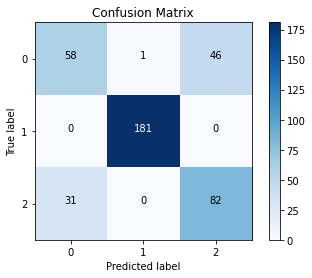

test accuracy: 0.8045112781954887
train accuracy: 0.9899497487437185
------------------------------------------------------------
------------------------------------------------------------
Confusion Matrix:
 Predicted   0    1    2  All
Actual                      
0          58    1   46  105
1           0  181    0  181
2          31    0   82  113
All        89  182  128  399

test report:
              precision    recall  f1-score   support

           0       0.65      0.55      0.60       105
           1       0.99      1.00      1.00       181
           2       0.64      0.73      0.68       113

    accuracy                           0.80       399
   macro avg       0.76      0.76      0.76       399
weighted avg       0.80      0.80      0.80       399

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


0.8

In [ ]:
from sklearn import metrics

results=evaluate_model(linear_svc, y_train, y_test, y_hat_train, y_hat_test)
svm_test_acc = round(accuracy_score(y_test, y_hat_test), 2)
svm_test_acc


In [ ]:
my_results = []
my_res = {
    "model": "LinearSVC",
    "type": "Linear Classifier",
    " Test Accuracy": results[0],
    
}
my_results.append(my_res)

my_res_df = pd.DataFrame(my_results)
my_res_df

,model,type,Test Accuracy
0,LinearSVC,Linear Classifier,0.804511


## MulitinomialNB

In [ ]:
from sklearn.naive_bayes import MultinomialNB
text_mnb = Pipeline([('tfidf', TfidfVectorizer(lowercase=True, stop_words=stopwords_list,
                                               tokenizer=text_tokenizer)),
                     ('clf', MultinomialNB())])

# Feed the training data through the pipeline
text_mnb.fit(X_train, y_train)
     

/usr/local/lib/python3.8/dist-packages/sklearn/feature_extraction/text.py:396: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ["'d", "'ll", "'re", "'s", "'ve", '``', 'could', 'might', 'must', "n't", 'need', 'sha', 'wo', 'would'] not in stop_words.
  warnings.warn(


Pipeline(steps=[('tfidf',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('clf', MultinomialNB())])

In [ ]:

#Predictions
y_hat_train=text_mnb.predict(X_train)
y_hat_test = text_mnb.predict(X_test)



Metrics

Classifier: Pipeline(steps=[('tfidf',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('clf', MultinomialNB())])
------------------------------------------------------------


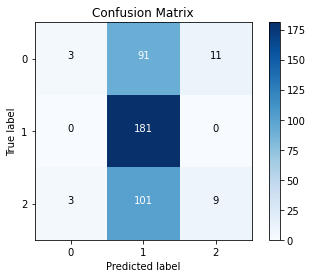

test accuracy: 0.48370927318295737
train accuracy: 0.6365159128978225
------------------------------------------------------------
------------------------------------------------------------
Confusion Matrix:
 Predicted  0    1   2  All
Actual                    
0          3   91  11  105
1          0  181   0  181
2          3  101   9  113
All        6  373  20  399

test report:
              precision    recall  f1-score   support

           0       0.50      0.03      0.05       105
           1       0.49      1.00      0.65       181
           2       0.45      0.08      0.14       113

    accuracy                           0.48       399
   macro avg       0.48      0.37      0.28       399
weighted avg       0.48      0.48      0.35       399

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


0.48

In [ ]:
results=evaluate_model(text_mnb, y_train, y_test, y_hat_train, y_hat_test)
mnb_test_acc = round(accuracy_score(y_test, y_hat_test), 2)
mnb_test_acc

In [ ]:
my_res = {
    "model": "MulitinomialNB",
    "type": "naive Bayes Classifier",
    " Test Accuracy": results[0],
    
}
my_results.append(my_res)

my_res_df = pd.DataFrame(my_results)
my_res_df

,model,type,Test Accuracy
0,LinearSVC,Linear Classifier,0.804511
1,MulitinomialNB,naive Bayes Classifier,0.483709


##SGDClassifier (stochastic gradient descent)



In [ ]:
from sklearn.linear_model import SGDClassifier
text_sgdc = Pipeline([('tfidf', TfidfVectorizer(lowercase=True, stop_words=stopwords_list,
                                                tokenizer=text_tokenizer)),
                     ('clf', SGDClassifier())])


text_sgdc.fit(X_train, y_train)
     


/usr/local/lib/python3.8/dist-packages/sklearn/feature_extraction/text.py:396: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ["'d", "'ll", "'re", "'s", "'ve", '``', 'could', 'might', 'must', "n't", 'need', 'sha', 'wo', 'would'] not in stop_words.
  warnings.warn(


Pipeline(steps=[('tfidf',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('clf', SGDClassifier())])

In [ ]:
#Predictions
y_hat_train=text_sgdc.predict(X_train)
y_hat_test = text_sgdc.predict(X_test)


    

#Metrics

Classifier: Pipeline(steps=[('tfidf',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('clf', SGDClassifier())])
------------------------------------------------------------


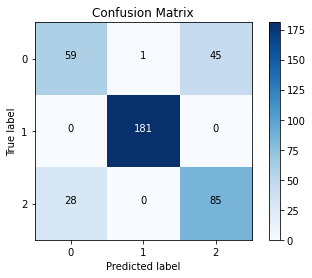

test accuracy: 0.8145363408521303
train accuracy: 0.9916247906197655
------------------------------------------------------------
------------------------------------------------------------
Confusion Matrix:
 Predicted   0    1    2  All
Actual                      
0          59    1   45  105
1           0  181    0  181
2          28    0   85  113
All        87  182  130  399

test report:
              precision    recall  f1-score   support

           0       0.68      0.56      0.61       105
           1       0.99      1.00      1.00       181
           2       0.65      0.75      0.70       113

    accuracy                           0.81       399
   macro avg       0.78      0.77      0.77       399
weighted avg       0.81      0.81      0.81       399

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


0.81

In [ ]:
results=evaluate_model(text_sgdc, y_train, y_test, y_hat_train, y_hat_test)
sgd_test_acc = round(accuracy_score(y_test, y_hat_test), 2)
sgd_test_acc
     

In [ ]:
# Collecting Results
my_res = {
    "model": "SGD",
    "type": "Stochastic Gradient Descent (SGD)",
    " Test Accuracy": results[0],
    
}
my_results.append(my_res)

my_res_df = pd.DataFrame(my_results)
my_res_df
     
     

,model,type,Test Accuracy
0,LinearSVC,Linear Classifier,0.804511
1,MulitinomialNB,naive Bayes Classifier,0.483709
2,SGD,Stochastic Gradient Descent (SGD),0.814536


## LogisticRegression

In [ ]:
from sklearn.linear_model import LogisticRegression
text_lr = Pipeline([('tfidf', TfidfVectorizer(lowercase=True, stop_words=stopwords_list,
                                              tokenizer=text_tokenizer)),
                     ('clf', LogisticRegression())])

text_lr.fit(X_train, y_train)
     


/usr/local/lib/python3.8/dist-packages/sklearn/feature_extraction/text.py:396: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ["'d", "'ll", "'re", "'s", "'ve", '``', 'could', 'might', 'must', "n't", 'need', 'sha', 'wo', 'would'] not in stop_words.
  warnings.warn(


Pipeline(steps=[('tfidf',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('clf', LogisticRegression())])

In [ ]:
#Predictions
y_hat_train=text_lr.predict(X_train)
y_hat_test = text_lr.predict(X_test)




##Metrics

Classifier: Pipeline(steps=[('tfidf',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('clf', LogisticRegression())])
------------------------------------------------------------


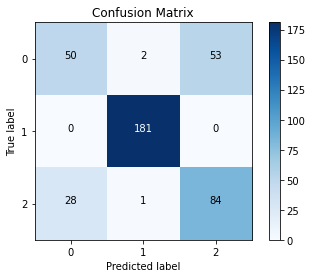

test accuracy: 0.7894736842105263
train accuracy: 0.983249581239531
------------------------------------------------------------
------------------------------------------------------------
Confusion Matrix:
 Predicted   0    1    2  All
Actual                      
0          50    2   53  105
1           0  181    0  181
2          28    1   84  113
All        78  184  137  399

test report:
              precision    recall  f1-score   support

           0       0.64      0.48      0.55       105
           1       0.98      1.00      0.99       181
           2       0.61      0.74      0.67       113

    accuracy                           0.79       399
   macro avg       0.75      0.74      0.74       399
weighted avg       0.79      0.79      0.78       399

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


In [ ]:
results=evaluate_model(text_lr, y_train, y_test, y_hat_train, y_hat_test)
lgr_test_acc = round(accuracy_score(y_test, y_hat_test), 2)
 

In [ ]:
my_res = {
    "model": "LogisticRegression",
    "type": "Classifier",
    " Test Accuracy": results[0],
    
}
my_results.append(my_res)

my_res_df = pd.DataFrame(my_results)
my_res_df

,model,type,Test Accuracy
0,LinearSVC,Linear Classifier,0.804511
1,MulitinomialNB,naive Bayes Classifier,0.483709
2,SGD,Stochastic Gradient Descent (SGD),0.814536
3,LogisticRegression,Classifier,0.789474


# RandomForestClassifier

In [ ]:
from sklearn.ensemble import RandomForestClassifier
text_rfc = Pipeline([('tfidf', TfidfVectorizer(lowercase=True, stop_words=stopwords_list,
                                               tokenizer=text_tokenizer)),
                     ('clf', RandomForestClassifier(class_weight='balanced'))])

text_rfc.fit(X_train, y_train)
     

/usr/local/lib/python3.8/dist-packages/sklearn/feature_extraction/text.py:396: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ["'d", "'ll", "'re", "'s", "'ve", '``', 'could', 'might', 'must', "n't", 'need', 'sha', 'wo', 'would'] not in stop_words.
  warnings.warn(


Pipeline(steps=[('tfidf',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('clf', RandomForestClassifier(class_weight='balanced'))])

In [ ]:
#Predictions
y_hat_train=text_rfc.predict(X_train)
y_hat_test = text_rfc.predict(X_test)


# Metrics

Classifier: Pipeline(steps=[('tfidf',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('clf', RandomForestClassifier(class_weight='balanced'))])
------------------------------------------------------------


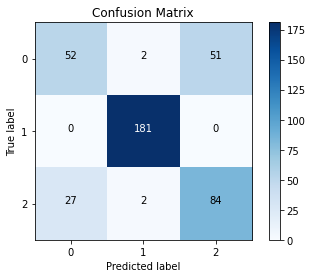

test accuracy: 0.7944862155388471
train accuracy: 1.0
------------------------------------------------------------
------------------------------------------------------------
Confusion Matrix:
 Predicted   0    1    2  All
Actual                      
0          52    2   51  105
1           0  181    0  181
2          27    2   84  113
All        79  185  135  399

test report:
              precision    recall  f1-score   support

           0       0.66      0.50      0.57       105
           1       0.98      1.00      0.99       181
           2       0.62      0.74      0.68       113

    accuracy                           0.79       399
   macro avg       0.75      0.75      0.74       399
weighted avg       0.79      0.79      0.79       399

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


0.79

In [ ]:
results=evaluate_model(text_rfc, y_train, y_test, y_hat_train, y_hat_test)
rf_test_acc = round(accuracy_score(y_test, y_hat_test), 2)
rf_test_acc
     


In [ ]:
my_res = {
    "model": "RandomForestClassifier",
    "type": "Class=WeightBalance",
    " Test Accuracy": results[0],
    
}
my_results.append(my_res)

my_res_df = pd.DataFrame(my_results)
my_res_df

,model,type,Test Accuracy
0,LinearSVC,Linear Classifier,0.804511
1,MulitinomialNB,naive Bayes Classifier,0.483709
2,SGD,Stochastic Gradient Descent (SGD),0.814536
3,LogisticRegression,Classifier,0.789474
4,RandomForestClassifier,Class=WeightBalance,0.794486


 my models showed different accuracy, however there is a big discrepancy between train and test, this discrepancy shows an overfitting issue and can be solved by adjusting the weight balance in all classes and hypertuning the parameters. I will play first with the weight balance. Later, I will work in optimizing the parameters. Since Stochastic Gradient Descent (SGD)	 showed the best result,I will further work in balancing the classes with smote techniques.

## Balancing with Smote
SMOTE (Synthetic Minority Over-sampling Technique) is a popular method used in machine learning to balance class imbalances by generating synthetic samples in the minority class. The technique works by selecting similar instances in the minority class and creating new synthetic samples along the line connecting the selected instances and their nearest neighbors in the minority class. SMOTE helps overcome the issue of having a small number of instances in the minority class, which can lead to biased learning models.



In [ ]:
from imblearn.pipeline import make_pipeline # make_pipeline from imblearn library is used for dealing with imbalanced dataset
from imblearn.over_sampling import  SMOTE
from sklearn.model_selection import GridSearchCV

tfidf = TfidfVectorizer(lowercase=True, stop_words=stopwords_list,
                            tokenizer=text_tokenizer)

sgdc =SGDClassifier()

     

sgdc - SMOTE


In [ ]:
SMOTE_pipeline = make_pipeline(tfidf, SMOTE(random_state=123),sgdc)
SMOTE_pipeline.fit(X_train, y_train)
  

/usr/local/lib/python3.8/dist-packages/sklearn/feature_extraction/text.py:396: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ["'d", "'ll", "'re", "'s", "'ve", '``', 'could', 'might', 'must', "n't", 'need', 'sha', 'wo', 'would'] not in stop_words.
  warnings.warn(


Pipeline(steps=[('tfidfvectorizer',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('smote', SMOTE(random_state=123)),
                ('sgdclassifier', SGDClassifier())])

In [ ]:
#Predictions
y_hat_train=SMOTE_pipeline.predict(X_train)
y_hat_test = SMOTE_pipeline.predict(X_test)


# Metrics

Classifier: Pipeline(steps=[('tfidfvectorizer',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('smote', SMOTE(random_state=123)),
                ('sgdclassifier', SGDClassifier())])
------------------------------------------------------------


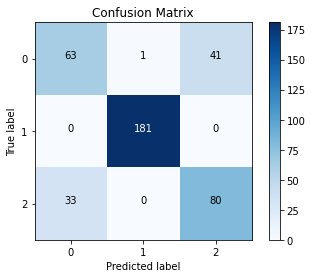

test accuracy: 0.8120300751879699
train accuracy: 0.9849246231155779
------------------------------------------------------------
------------------------------------------------------------
Confusion Matrix:
 Predicted   0    1    2  All
Actual                      
0          63    1   41  105
1           0  181    0  181
2          33    0   80  113
All        96  182  121  399

test report:
              precision    recall  f1-score   support

           0       0.66      0.60      0.63       105
           1       0.99      1.00      1.00       181
           2       0.66      0.71      0.68       113

    accuracy                           0.81       399
   macro avg       0.77      0.77      0.77       399
weighted avg       0.81      0.81      0.81       399

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


0.81

In [ ]:
results=evaluate_model(SMOTE_pipeline, y_train, y_test, y_hat_train, y_hat_test)
smote_sgd_test_acc = round(accuracy_score(y_test, y_hat_test), 2)
smote_sgd_test_acc 
     


In [ ]:
my_res = {
    "model": "SGD - SMOTE ",
    "type": "Stochastic Gradient Descent (SGD) Balanced by Smote",
    " Test Accuracy": results[0],
    
}
my_results.append(my_res)

my_res_df = pd.DataFrame(my_results)
my_res_df

,model,type,Test Accuracy
0,LinearSVC,Linear Classifier,0.804511
1,MulitinomialNB,naive Bayes Classifier,0.483709
2,SGD,Stochastic Gradient Descent (SGD),0.814536
3,LogisticRegression,Classifier,0.789474
4,RandomForestClassifier,Class=WeightBalance,0.794486
5,SGD - SMOTE,Stochastic Gradient Descent (SGD) Balanced by ...,0.812030


## RFC - SMOTE 
Trying balancing with Smote in Random forest model

In [ ]:

tfidf = TfidfVectorizer(lowercase=True, stop_words=stopwords_list,
                             tokenizer=text_tokenizer)

rfc = RandomForestClassifier(class_weight='balanced')
SMOTE_pipeline = make_pipeline(tfidf, SMOTE(random_state=123),rfc)
SMOTE_pipeline.fit(X_train, y_train)

/usr/local/lib/python3.8/dist-packages/sklearn/feature_extraction/text.py:396: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ["'d", "'ll", "'re", "'s", "'ve", '``', 'could', 'might', 'must', "n't", 'need', 'sha', 'wo', 'would'] not in stop_words.
  warnings.warn(


Pipeline(steps=[('tfidfvectorizer',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('smote', SMOTE(random_state=123)),
                ('randomforestclassifier',
                 RandomForestClassifier(class_weight='balanced'))])

In [ ]:
#Predictions
y_hat_train=SMOTE_pipeline.predict(X_train)
y_hat_test = SMOTE_pipeline.predict(X_test)


   

##Metrics

Classifier: Pipeline(steps=[('tfidfvectorizer',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('smote', SMOTE(random_state=123)),
                ('randomforestclassifier',
                 RandomForestClassifier(class_weight='balanced'))])
------------------------------------------------------------


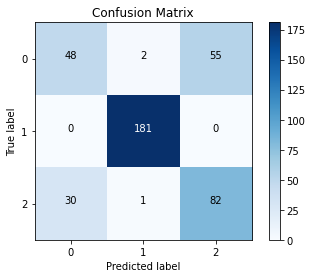

test accuracy: 0.7794486215538847
train accuracy: 1.0
------------------------------------------------------------
------------------------------------------------------------
Confusion Matrix:
 Predicted   0    1    2  All
Actual                      
0          48    2   55  105
1           0  181    0  181
2          30    1   82  113
All        78  184  137  399

test report:
              precision    recall  f1-score   support

           0       0.62      0.46      0.52       105
           1       0.98      1.00      0.99       181
           2       0.60      0.73      0.66       113

    accuracy                           0.78       399
   macro avg       0.73      0.73      0.72       399
weighted avg       0.78      0.78      0.77       399

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


0.78

In [ ]:
results=evaluate_model(SMOTE_pipeline, y_train, y_test, y_hat_train, y_hat_test)
smote_rf_test_acc = round(accuracy_score(y_test, y_hat_test), 2)
smote_rf_test_acc 

In [ ]:
my_res = {
    "model": "RFC - SMOTE ",
    "type": "Randomforest Balanced by Smote",
    " Test Accuracy": results[0],
    
}
my_results.append(my_res)

my_res_df = pd.DataFrame(my_results)
my_res_df

,model,type,Test Accuracy
0,LinearSVC,Linear Classifier,0.804511
1,MulitinomialNB,naive Bayes Classifier,0.483709
2,SGD,Stochastic Gradient Descent (SGD),0.814536
3,LogisticRegression,Classifier,0.789474
4,RandomForestClassifier,Class=WeightBalance,0.794486
5,SGD - SMOTE,Stochastic Gradient Descent (SGD) Balanced by ...,0.812030
6,RFC - SMOTE,Randomforest Balanced by Smote,0.779449


Smote Didn't make any improvement. Now, I will try hypertuning the parameters of randomforest classifier and I will keep working with smote on my train dataset

## Hyper Tunning
With tring smote there was no any improvment.Now I will try to hypertune the parameters and look for the best parameter and best estimator, so I can plug it again in my model and check if the metrics will improve.

In [ ]:
params = {'randomforestclassifier__criterion':['gini','entropy'],
             'randomforestclassifier__max_depth':[None, 5, 3, 10],
             'randomforestclassifier__min_samples_leaf': [1,2,3],
         'randomforestclassifier__max_features':['auto','sqrt',3,5,10,30,70]}
     

In [ ]:
SMOTE_pipeline = make_pipeline(tfidf, SMOTE(random_state=123),rfc)


In [ ]:
grid = GridSearchCV(SMOTE_pipeline, cv=5, n_jobs=-1, param_grid=params ,
                    scoring='recall_macro')
     

In [ ]:
grid.fit(X_train, y_train)

/usr/local/lib/python3.8/dist-packages/sklearn/feature_extraction/text.py:396: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ["'d", "'ll", "'re", "'s", "'ve", '``', 'could', 'might', 'must', "n't", 'need', 'sha', 'wo', 'would'] not in stop_words.
  warnings.warn(


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('tfidfvectorizer',
                                        TfidfVectorizer(stop_words=['i', 'me',
                                                                    'my',
                                                                    'myself',
                                                                    'we', 'our',
                                                                    'ours',
                                                                    'ourselves',
                                                                    'you',
                                                                    "you're",
                                                                    "you've",
                                                                    "you'll",
                                                                    "you'd",
                                                                   

In [ ]:

grid.score(X_test, y_test)

0.7783958421126563

## Research best estimator from grid


In [ ]:
grid.best_params_


{'randomforestclassifier__criterion': 'gini',
 'randomforestclassifier__max_depth': None,
 'randomforestclassifier__max_features': 'sqrt',
 'randomforestclassifier__min_samples_leaf': 3}

In [ ]:
# Research best estimator from grid
best_pipe = grid.best_estimator_

     

In [ ]:
best_pipe

Pipeline(steps=[('tfidfvectorizer',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('smote', SMOTE(random_state=123)),
                ('randomforestclassifier',
                 RandomForestClassifier(class_weight='balanced',
                                        max_features='sqrt',
                                 

In [ ]:

best_pipe.fit(X_train,y_train)
import time
start = time.time()

# code to be timed

end = time.time()
print("Time taken in seconds: ", end - start)

Pipeline(steps=[('tfidfvectorizer',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('smote', SMOTE(random_state=123)),
                ('randomforestclassifier',
                 RandomForestClassifier(class_weight='balanced',
                                        max_features='sqrt',
                                 

Time taken in seconds:  4.601478576660156e-05


In [ ]:
#Predictions
y_hat_train=best_pipe.predict(X_train)
y_hat_test = best_pipe.predict(X_test)


Classifier: Pipeline(steps=[('tfidfvectorizer',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('smote', SMOTE(random_state=123)),
                ('randomforestclassifier',
                 RandomForestClassifier(class_weight='balanced',
                                        max_features='sqrt',
                     

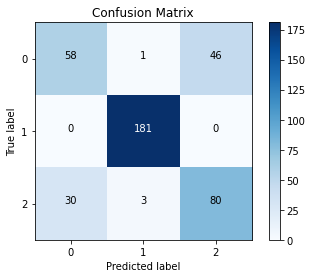

test accuracy: 0.7994987468671679
train accuracy: 0.9849246231155779
------------------------------------------------------------
------------------------------------------------------------
Confusion Matrix:
 Predicted   0    1    2  All
Actual                      
0          58    1   46  105
1           0  181    0  181
2          30    3   80  113
All        88  185  126  399

test report:
              precision    recall  f1-score   support

           0       0.66      0.55      0.60       105
           1       0.98      1.00      0.99       181
           2       0.63      0.71      0.67       113

    accuracy                           0.80       399
   macro avg       0.76      0.75      0.75       399
weighted avg       0.80      0.80      0.80       399

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


0.8

In [ ]:
results=evaluate_model(best_pipe, y_train, y_test, y_hat_train, y_hat_test)
rf_gridsearch_test_acc = round(accuracy_score(y_test,y_hat_test), 2)
rf_gridsearch_test_acc


In [ ]:
my_res = {
    "model": "RFC -GridSearch ",
    "type": "Randomforest Hypertuned by best estimator",
    " Test Accuracy": results[0],
    
}
my_results.append(my_res)

my_res_df = pd.DataFrame(my_results)
my_res_df
     

,model,type,Test Accuracy
0,LinearSVC,Linear Classifier,0.804511
1,MulitinomialNB,naive Bayes Classifier,0.483709
2,SGD,Stochastic Gradient Descent (SGD),0.814536
3,LogisticRegression,Classifier,0.789474
4,RandomForestClassifier,Class=WeightBalance,0.794486
5,SGD - SMOTE,Stochastic Gradient Descent (SGD) Balanced by ...,0.812030
6,RFC - SMOTE,Randomforest Balanced by Smote,0.779449
7,RFC -GridSearch,Randomforest Hypertuned by best estimator,0.799499


### Hypertunning also didn't add any noticeable improvement. The accuracy only  improved from 0.795 to 0.799 So I I will try other models that are well-known for their good accuracy results such as AdaBoost,XGBoost and neural network.


In [ ]:
# Define the hyperparameter  grid to search of Stochastic Gradient Descent (SGD)
#params = {'loss': ['hinge', 'log', 'squared_loss'],'penalty': ['l1', 'l2', 'elasticnet'],'alpha':[0.0001, 0.001, 0.01, 0.1, 1]}


## Defenition of the parameters of SGDClassifier

The loss parameter in the SGDClassifier defines the loss function used to train the model.The loss function can be 'hinge' (for linear SVM), 'log' (for logistic regression), or 'squared_loss' (for linear regression).

The penalty parameter specifies the type of regularization to use during training, which helps to prevent overfitting. The options are 'l1' (L1 regularization), 'l2' (L2 regularization), or 'elasticnet' (a combination of L1 and L2 regularization).

The alpha parameter is the regularization strength, which determines the impact of the regularization term in the loss function. A smaller value of alpha means a stronger regularization, and a larger value of alpha means a weaker regularization.

The l1_ratio parameter specifies the balance between L1 and L2 regularization, if the 'elasticnet' penalty is used. A value of 0 means only L2 regularization is used, a value of 1 means only L1 regularization is used, and values in between result in a combination of L1 and L2 regularization.

By searching over the values specified in the hyperparameter grid, the grid search will find the combination of hyperparameters that results in the best performance of the model.

In [ ]:
#SMOTE_pipeline = make_pipeline(tfidf, SMOTE(random_state=123),sgdc)



In [ ]:
# # Create an instance of the GridSearchCV
#grid = GridSearchCV(SMOTE_pipeline, cv=5, n_jobs=-1, param_grid=params ,
                    #scoring='recall_macro')#cv parameter specifies the number of folds to use for cross-validation.
   

In [ ]:

## Fit the grid search to the data
#grid.fit(X_train, y_train)





ValueError: ignored

### AdaBoost Classifier

In [ ]:
# Instantiate classifier, fit, and predict on test data
from sklearn.ensemble import  AdaBoostClassifier


text_adc=Pipeline([('tfidf', TfidfVectorizer(lowercase=True, stop_words=stopwords_list,
                                               tokenizer=text_tokenizer)),
                     ('clf', AdaBoostClassifier())])

text_adc.fit(X_train, y_train)


/usr/local/lib/python3.8/dist-packages/sklearn/feature_extraction/text.py:396: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ["'d", "'ll", "'re", "'s", "'ve", '``', 'could', 'might', 'must', "n't", 'need', 'sha', 'wo', 'would'] not in stop_words.
  warnings.warn(


Pipeline(steps=[('tfidf',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('clf', AdaBoostClassifier())])

In [ ]:
#Predictions
y_hat_train=text_adc.predict(X_train)
y_hat_test = text_adc.predict(X_test)

     

Classifier: Pipeline(steps=[('tfidf',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('clf', AdaBoostClassifier())])
------------------------------------------------------------


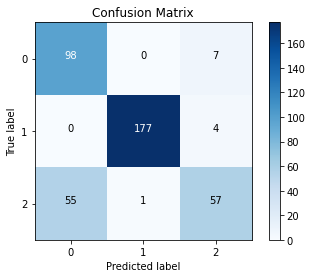

test accuracy: 0.8320802005012531
train accuracy: 0.8626465661641541
------------------------------------------------------------
------------------------------------------------------------
Confusion Matrix:
 Predicted    0    1   2  All
Actual                      
0           98    0   7  105
1            0  177   4  181
2           55    1  57  113
All        153  178  68  399

test report:
              precision    recall  f1-score   support

           0       0.64      0.93      0.76       105
           1       0.99      0.98      0.99       181
           2       0.84      0.50      0.63       113

    accuracy                           0.83       399
   macro avg       0.82      0.81      0.79       399
weighted avg       0.86      0.83      0.83       399

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


0.83

In [ ]:
# Evaluate classifier
results=evaluate_model(text_adc, y_train, y_test, y_hat_train, y_hat_test)

ada_test_acc = round(accuracy_score(y_test, y_hat_test), 2)
ada_test_acc
     

So far AdaBoost Classifier is the best classifier  where the training accuracy and testing score are close i.e. 83% for testting and 86% for training

### Summarizing Results

In [ ]:
my_res = {
    "model": "text_adc ",
    "type": "AdaBoost classifier ",
    " Test Accuracy": results[0],
    
}
my_results.append(my_res)

my_res_df = pd.DataFrame(my_results)
my_res_df


,model,type,Test Accuracy
0,LinearSVC,Linear Classifier,0.804511
1,MulitinomialNB,naive Bayes Classifier,0.483709
2,SGD,Stochastic Gradient Descent (SGD),0.814536
3,LogisticRegression,Classifier,0.789474
4,RandomForestClassifier,Class=WeightBalance,0.794486
5,SGD - SMOTE,Stochastic Gradient Descent (SGD) Balanced by ...,0.812030
6,RFC - SMOTE,Randomforest Balanced by Smote,0.779449
7,RFC -GridSearch,Randomforest Hypertuned by best estimator,0.799499
8,text_adc,AdaBoost classifie,0.832080


### XGBoost Classifier

In [ ]:
import time

start_time = time.time()
# Instantiate classifier, fit, and predict on test data


text_xgb = Pipeline([('tfidf', TfidfVectorizer(lowercase=True, stop_words=stopwords_list,
                                              tokenizer=text_tokenizer)),
                     ('clf', XGBClassifier())])

text_xgb.fit(X_train, y_train)
print("--- %s seconds ---" % (time.time() - start_time))



Pipeline(steps=[('tfidf',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('clf', XGBClassifier(objective='multi:softprob'))])

--- 85.11068153381348 seconds ---


In [ ]:
#Predictions
y_hat_train=text_xgb.predict(X_train)
y_hat_test = text_xgb.predict(X_test)

     


Classifier: Pipeline(steps=[('tfidf',
                 TfidfVectorizer(stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...],
                                 tokenizer=<function text_tokenizer at 0x7fce0135eb80>)),
                ('clf', XGBClassifier(objective='multi:softprob'))])
------------------------------------------------------------


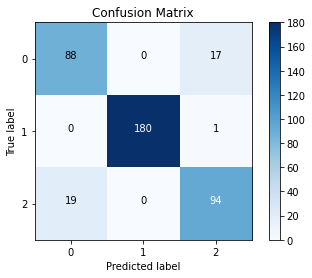

test accuracy: 0.9072681704260651
train accuracy: 1.0
------------------------------------------------------------
------------------------------------------------------------
Confusion Matrix:
 Predicted    0    1    2  All
Actual                       
0           88    0   17  105
1            0  180    1  181
2           19    0   94  113
All        107  180  112  399

test report:
              precision    recall  f1-score   support

           0       0.82      0.84      0.83       105
           1       1.00      0.99      1.00       181
           2       0.84      0.83      0.84       113

    accuracy                           0.91       399
   macro avg       0.89      0.89      0.89       399
weighted avg       0.91      0.91      0.91       399

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


0.91

In [ ]:
results=evaluate_model(text_xgb, y_train, y_test, y_hat_train, y_hat_test)
xgb_test_acc = round(accuracy_score(y_test, y_hat_test), 2)
xgb_test_acc
   
   

XGBoost Classifier shows better accuraacy score and there is small difference btween the testing  accuracy score i.e.  91% and the training accuracy score which is 100%. Howervr such an accuracy score is an indicate oof overfitting isssue

In [ ]:
my_res = {
    "model": "text_xgb ",
    "type": "XGBoost Classifier ",
    " Test Accuracy": results[0],
    
}
my_results.append(my_res)

my_res_df = pd.DataFrame(my_results)
my_res_df
     


,model,type,Test Accuracy
0,LinearSVC,Linear Classifier,0.804511
1,MulitinomialNB,naive Bayes Classifier,0.483709
2,SGD,Stochastic Gradient Descent (SGD),0.814536
3,LogisticRegression,Classifier,0.789474
4,RandomForestClassifier,Class=WeightBalance,0.794486
5,SGD - SMOTE,Stochastic Gradient Descent (SGD) Balanced by ...,0.812030
6,RFC - SMOTE,Randomforest Balanced by Smote,0.779449
7,RFC -GridSearch,Randomforest Hypertuned by best estimator,0.799499
8,text_adc,AdaBoost classifie,0.832080
9,text_xgb,XGBoost Classifier,0.907268


In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(max_features=100)
X_train = vectorizer.fit_transform(X_train).toarray()
X_test = vectorizer.transform(X_test).toarray()

model = Sequential()

model.add(Dense(100, input_dim=100, activation='relu'))
model.add(Dense(3, activation='softmax'))

model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', 
              metrics=['accuracy'])

model.fit(X_train, y_train, epochs=5, batch_size=100, 
          validation_data=(X_test, y_test))

AttributeError: ignored

## Neural Network Classifier

In [ ]:
import time
start_time = time.time()

# Define simple neural network model
vectorizer = TfidfVectorizer(max_features=100)
X_train = vectorizer.fit_transform(X_train)
X_test = vectorizer.transform(X_test)

model = Sequential()
model.add(Dense(100, input_dim=100, activation='relu'))
model.add(Dense(3, activation='softmax'))

# Compile model

model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', 
              metrics=['accuracy'])

# Fit to training data
model.fit(X_train, y_train, epochs=5, batch_size=100, 
          validation_data=(X_test, y_test))

print("--- %s seconds ---" % (time.time() - start_time))


Epoch 1/5


InvalidArgumentError: ignored